In [142]:
using Plots
using SparseArrays: spdiagm
using LinearAlgebra
using Polynomials
using SparseArrays

In [143]:
#Defining a wavefunction
function wavefunction(x)
    wave_function = exp(-im*20*x)*exp(-3*(x-2)^2)
    return wave_function
end

function prob_wavefunction(x)
    prob_wave = (wavefunction(x))*(conj(wavefunction(x)))
    return prob_wave
end

prob_wavefunction (generic function with 2 methods)

In [144]:
# L = 5
# dx = 0.01
# dx_1 = collect(0.00001:0.0001:0.05)
# #print(length(dx_1))
# for i in dx_1
#     print(i,"\n")
# end

#x = collect(-L:dx:L)
#print(length(x))

# Normalizing the wavefunction

In [145]:
#using the rectangular method
function rect_integral(L,dx,wave_function)
   x = collect(-L:dx:L)
   phi = wave_function.(x)
   phi_conjugate = conj(phi)
   N_integ = sum(phi_conjugate.*phi)*dx
   return N_integ
end
N_integ = rect_integral(10,0.01,wavefunction)

0.7236012545582677 + 0.0im

In [146]:
#using the simpson method
function simpson_var_1(L,dx,probablity_wavefunction)
    x = collect(-L:dx:L)
    h=length(x)
    N = 0
    for (i,value) in enumerate(x)
       if (value != -15) & (value != 15)
          if i%2==0
              N = N+4*probablity_wavefunction(value)
          else
              N = N + 2*probablity_wavefunction(value)
          end
       end
   end
   N = N + probablity_wavefunction(15)+probablity_wavefunction(-15)
   N = N*(dx/3)
   return N
end

integral_1 = simpson_var_1(10,0.1,prob_wavefunction)

0.7236012545582675 + 0.0im

In [147]:
function error_calc_1(L,function_1,function_2)
    L = L
    #point = [0.5,1.5]
    #dx_1 = collect(0.0000001:0.000001:1)
    dx_1 = LinRange(0.0001,1,1000)
    dx_1_2 = collect(dx_1)
    t = (pi)^0.5
    error = []
    for i in dx_1
        integral_1 = function_1(L,i,function_2)
        #integral_2 = function_3(L,i,function_4)
        diff = t - integral_1
        append!(error,diff)
    end
    return dx_1_2,error
end

error_calc_1 (generic function with 1 method)

In [148]:
step_size, error = error_calc_1(5,rect_integral,wavefunction)

([0.0001, 0.001100900900900901, 0.002101801801801802, 0.0031027027027027026, 0.004103603603603604, 0.005104504504504504, 0.006105405405405405, 0.0071063063063063064, 0.008107207207207208, 0.009108108108108108  …  0.9909918918918919, 0.9919927927927927, 0.9929936936936937, 0.9939945945945946, 0.9949954954954955, 0.9959963963963964, 0.9969972972972972, 0.9979981981981982, 0.9989990990990991, 1.0], Any[1.0488525963472484 - 0.0im, 1.0488525963472486 - 0.0im, 1.0488525963472484 - 0.0im, 1.0488525963472486 - 0.0im, 1.0488525963472486 - 0.0im, 1.0488525963472486 - 0.0im, 1.0488525963472486 - 0.0im, 1.0488525963472484 - 0.0im, 1.0488525963472486 - 0.0im, 1.0488525963472486 - 0.0im  …  0.7979085446145994 - 0.0im, 0.7924476378291205 - 0.0im, 0.787484876035713 - 0.0im, 0.7830314907212272 - 0.0im, 0.7790976152460951 - 0.0im, 0.7756922644461097 - 0.0im, 0.772823316976169 - 0.0im, 0.7704975004565664 - 0.0im, 0.7687203794735602 - 0.0im, 0.7674963464766809 - 0.0im])

In [149]:
step_size_1,error_1 = error_calc_1(5,simpson_var_1,prob_wavefunction)

([0.0001, 0.001100900900900901, 0.002101801801801802, 0.0031027027027027026, 0.004103603603603604, 0.005104504504504504, 0.006105405405405405, 0.0071063063063063064, 0.008107207207207208, 0.009108108108108108  …  0.9909918918918919, 0.9919927927927927, 0.9929936936936937, 0.9939945945945946, 0.9949954954954955, 0.9959963963963964, 0.9969972972972972, 0.9979981981981982, 0.9989990990990991, 1.0], Any[1.0488525963472615 - 0.0im, 1.04885259634725 - 0.0im, 1.0488525963472513 - 0.0im, 1.04885259634725 - 0.0im, 1.0488525963472481 - 0.0im, 1.0488525963472477 - 0.0im, 1.0488525963472497 - 0.0im, 1.0488525963472493 - 0.0im, 1.048852596347249 - 0.0im, 1.048852596347249 - 0.0im  …  0.4776705439404634 - 0.0im, 0.47013707870183974 - 0.0im, 0.4632973638280422 - 0.0im, 0.4571650309326152 - 0.0im, 0.45175235859730734 - 0.0im, 0.4470702427063711 - 0.0im, 0.44312817041848507 - 0.0im, 0.4399341978749183 - 0.0im, 0.4374949317291581 - 0.0im, 0.4358155145692908 - 0.0im])

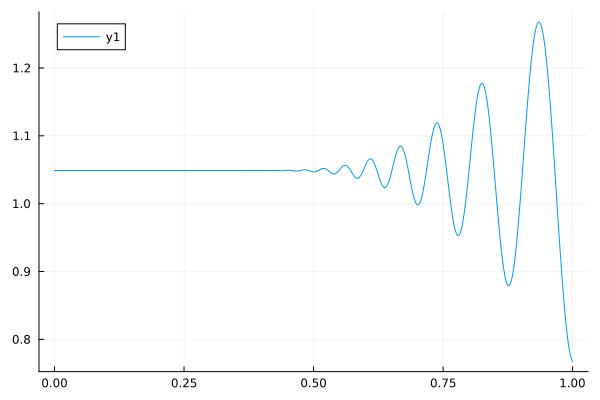

In [150]:
plot(step_size,error)

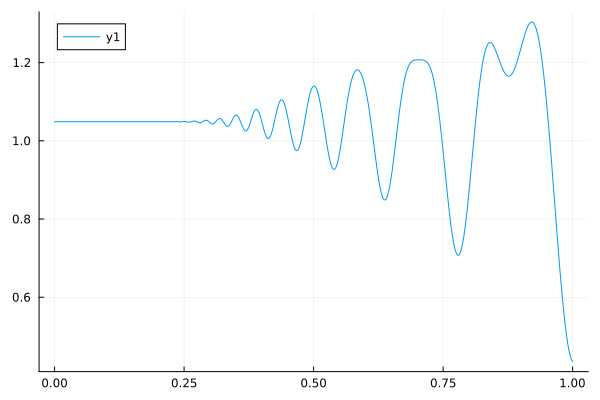

In [151]:
plot(step_size_1,error_1)

In [152]:
function norml(L,dx,x)                     #Gives normalised wavefunction
    return wavefunction.(x)/sqrt(abs.(simpson_var_1(L,dx,prob_wavefunction)))
end


norml (generic function with 2 methods)

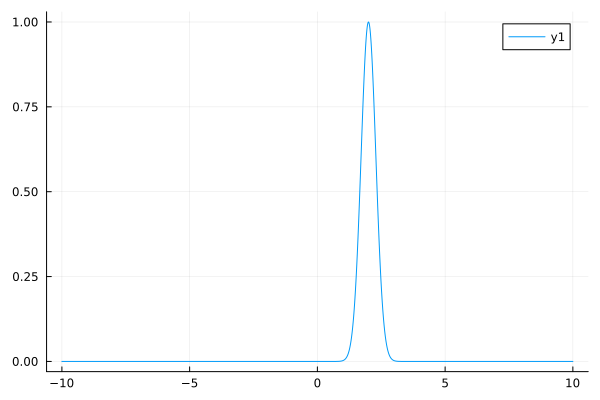

-2.0097283446402206e-15 - 2.845981654712507e-15im

In [153]:
L = 10
dx = 0.01
x = collect(-L:dx:L)
wf=wavefunction.(x)
#wf_1 = wavefunction(x)
display(plot(x,abs.(wf.*conj(wf))))                                 #Plot for wavefunction
iwf=simpson_var_1(10,0.01,wavefunction)
print(iwf)


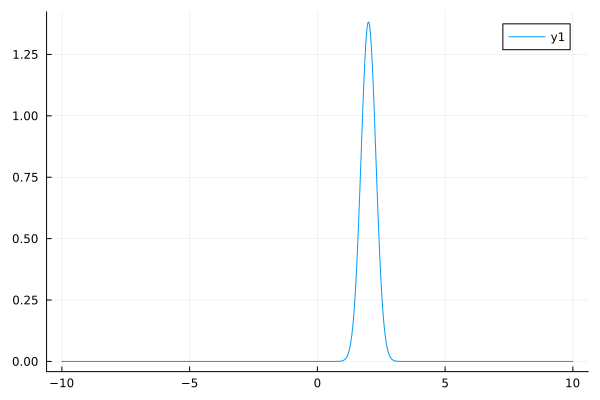

0.7236012545582673 + 0.0im

In [154]:
nwf = norml(10,0.01,x)
display(plot(x,abs.(nwf.*conj(nwf))))
t = simpson_var_1(10,0.01,prob_wavefunction)

In [155]:
# function Simpson(fn,h)
#     N = length(fn)
#     sum = ( fn[1]+ fn[N] ) 
    
#     for i=2:N-1
#         sum+= (4-2*(i%2))*fn[i]
#     end
    
#     sum = h*sum/3
# return sum
# end

In [156]:
# L = 10
# dx = 0.01
# x = collect(-L:dx:L)
# Psi = prob_wavefunction.(x)
# t = Simpson([p for p in Psi],dx)

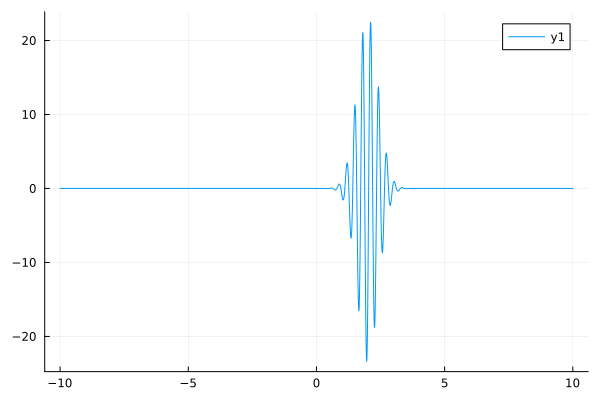

In [157]:
l=length(x)
D_1 = spdiagm(0 => fill(-1,l), 1 => fill(1,l-1))            #Operator for first derivative
Psi_1=D_1*nwf/dx
plot(x,real(Psi_1))

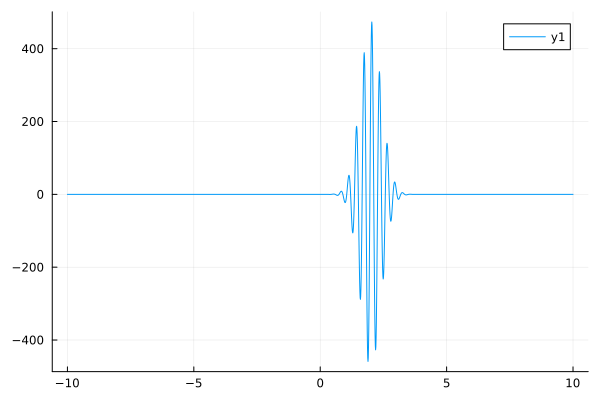

In [158]:
D_2 =spdiagm(1=> fill(1,l-1),0 => fill(-2,l), -1=> fill(1,l-1))                #Operator for second derivative
Psi_2=D_2*nwf/(dx)^2
plot(x,real(Psi_2))

In [159]:
function coefficients(k)
    mat=zeros(k,k)
    for i in 1:k
        for j in 1:k
            mat[i,j]=2*(i)^(2*j)/factorial(2*j)
        end
    end
    Inv=inv(mat)
    
    C=zeros(1,k+1)
    C[1]=-2*sum(Inv[1,:])
    C[2:k+1]=Inv[1,1:end]
    return C
end



println(coefficients(4))


[-2.8472222222222374 1.6000000000000119 -0.2000000000000055 0.02539682539682675 -0.0017857142857144043]


In [160]:
function Pade(M)
    C = zeros(M,M)
    C0 = zeros(M,1)
    for i in 1:M
        C0[i,1] = -1/factorial(M+i)
        for j in 1:M
            C[i,j] = 1/factorial(M+i-j)
        end
    end
    B = inv(C)*C0
    
    poly = Polynomial([1;B], :z)
    root = roots(poly)
    root=-conj(root)
    return root
end


Pade (generic function with 1 method)

In [161]:
r=4
M=4
coeff=coefficients(r)
dx=0.01
dt=0.001
m=1
b=im*dt/(2*m*(dx^2))
MAT=[]
for n in 1:M
    z1=Pade(M)[n]
    a=complex(zeros(r+1))
    for i = 1:r+1
        a[i]=b*coeff[i] /z1
    end
    d=1+a[1]
    A=complex(zeros(length(x),length(x)))
    for i in 1:length(x)
        for j in 1:length(x)
            if i==j
                A[i,j]=d
            end
            for k in 1:length(a)
                if j==i+k || j==i-k
                    A[i,j]=a[k]
                end
            end
        end
    end
    push!(MAT,A) 
end


In [162]:
Final=1
for i in M
    Final*=MAT[i]
end
Inv_Final=inv(Final)
Conj_Final=conj(Final)

2001×2001 Matrix{ComplexF64}:
    0.324624-2.25548im     …          0.0-0.0im
   -0.675376-2.25548im                0.0-0.0im
    0.379528+1.26747im                0.0-0.0im
   -0.047441-0.158434im               0.0-0.0im
  0.00602426+0.0201186im              0.0-0.0im
 -0.00042358-0.00141459im  …          0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im         …          0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im                    0.0-0.0im
            ⋮              ⋱             ⋮
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im         …          0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.0im                    0.0-0.0im
         0.0-0.

In [163]:
x=collect(-10:dx:10)
wf=wavefunction.(x)
nwf=wf
N=10000
wave=zeros(length(x),N)
wave=complex(wave)
wave[:,1]=nwf
for n=2:N
    Psi_new=Inv_Final*Conj_Final*nwf
    wave[:,n]=Psi_new
    nwf=Psi_new  
end

In [164]:
plot(x,abs.(wave[:,10000]))

anim = @animate for i = 1:N
    plot(x, abs.(conj(wave[:,i]).*wave[:,i]), legend=false)
end


Animation("/tmp/jl_9SMseJ", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "009991.png", "009992.png", "009993.png", "009994.png", "009995.png", "009996.png", "009997.png", "009998.png", "009999.png", "010000.png"])

In [165]:
gif(anim, "wave.gif", fps = N)

[ Info: Saved animation to /home/naj/Documents/PYL800/wave.gif


Plots.AnimatedGif("/home/naj/Documents/PYL800/wave.gif")